In [1]:
import pandas as pd
import numpy as np
import cv2
import os
import re

from PIL import Image

import albumentations as A
from albumentations.pytorch.transforms import ToTensorV2

import torch
import torchvision

from torchvision.models.detection.faster_rcnn import FastRCNNPredictor, FasterRCNN_ResNet50_FPN_Weights
from torchvision.models.detection import FasterRCNN
from torchvision.models.detection.rpn import AnchorGenerator

from torch.utils.data import Dataset, DataLoader
from torch.utils.data.sampler import SequentialSampler

from matplotlib import pyplot as plt

DIR_INPUT = '/kaggle/input/global-wheat-detection'
DIR_TRAIN = f'{DIR_INPUT}/train'
DIR_TEST = f'{DIR_INPUT}/test'

# Datasets

In [2]:
train_df = pd.read_csv(f'{DIR_INPUT}/train.csv')
train_df.shape

(147793, 5)

In [3]:
train_df['x'] = -1
train_df['y'] = -1
train_df['w'] = -1
train_df['h'] = -1

def expand_bbox(x):
    r = np.array(re.findall("([0-9]+[.]?[0-9]*)", x))
    if len(r) == 0:
        r = [-1, -1, -1, -1]
    return r

train_df[['x', 'y', 'w', 'h']] = np.stack(train_df['bbox'].apply(lambda x: expand_bbox(x)))
train_df.drop(columns=['bbox'], inplace=True)
train_df['x'] = train_df['x'].astype(np.float32)
train_df['y'] = train_df['y'].astype(np.float32)
train_df['w'] = train_df['w'].astype(np.float32)
train_df['h'] = train_df['h'].astype(np.float32)

In [4]:
train_df

,image_id,width,height,source,x,y,w,h
0,b6ab77fd7,1024,1024,usask_1,834.0,222.0,56.0,36.0
1,b6ab77fd7,1024,1024,usask_1,226.0,548.0,130.0,58.0
2,b6ab77fd7,1024,1024,usask_1,377.0,504.0,74.0,160.0
3,b6ab77fd7,1024,1024,usask_1,834.0,95.0,109.0,107.0
4,b6ab77fd7,1024,1024,usask_1,26.0,144.0,124.0,117.0
...,...,...,...,...,...,...,...,...
147788,5e0747034,1024,1024,arvalis_2,64.0,619.0,84.0,95.0
147789,5e0747034,1024,1024,arvalis_2,292.0,549.0,107.0,82.0
147790,5e0747034,1024,1024,arvalis_2,134.0,228.0,141.0,71.0
147791,5e0747034,1024,1024,arvalis_2,430.0,13.0,184.0,79.0


In [5]:
image_ids = train_df['image_id'].unique()
train_ids = image_ids[:-665]
val_ids = image_ids[-665:]

In [6]:
valid_df = train_df[train_df['image_id'].isin(val_ids)]
train_df = train_df[train_df['image_id'].isin(train_ids)]

In [7]:
valid_df.shape, train_df.shape

((25006, 8), (122787, 8))

In [8]:
class WheatDataset(Dataset):
    
    def __init__(self, dataframe, image_dir, transforms=None):
        super().__init__()
        
        self.image_ids = dataframe['image_id'].unique()
        self.df = dataframe
        self.image_dir = image_dir
        self.transforms = transforms
        
    def __getitem__(self, idx: int):
        image_id = self.image_ids[idx]
        records = self.df[self.df['image_id'] == image_id]
        
        image = cv2.imread(f"{self.image_dir}/{image_id}.jpg", cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0
        
        boxes = records[['x', 'y', 'w', 'h']].values
        boxes[:, 2] = boxes[:, 0] + boxes[:, 2]
        boxes[:, 3] = boxes[:, 1] + boxes[:, 3]
        
        area = (boxes[:, 3] - boxes[:, 1]) * (boxes[:, 2] - boxes[:, 0])
        area = torch.as_tensor(area, dtype=torch.float32)
        
        labels = torch.ones((records.shape[0],), dtype=torch.int64)
        
        iscrowd = torch.zeros((records.shape[0],), dtype=torch.int64)
        
        target = {}
        target['boxes'] = boxes
        target['labels'] = labels
        #target['masks'] = None
        target['image_id'] = torch.tensor([idx])
        target['area'] = area
        target['iscrowd'] = iscrowd
        
        if self.transforms:
            sample = {
                'image': image,
                'bboxes': target['boxes'],
                'labels': labels
            }
            sample = self.transforms(**sample)
            image = sample['image']
            
            target['boxes'] = torch.stack(tuple(map(torch.tensor, zip(*sample['bboxes'])))).permute(1, 0)
        
        return image, target, image_id
    
    def __len__(self) -> int:
        return self.image_ids.shape[0]
        

In [9]:
# Albumentations
def get_train_transform():
    return A.Compose([
        A.Flip(0.5),
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

def get_valid_transform():
    return A.Compose([
        ToTensorV2(p=1.0)
    ], bbox_params={'format': 'pascal_voc', 'label_fields': ['labels']})

# Model

In [10]:
model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 161MB/s]  


In [11]:
# 1 class (wheat) + background
num_classes = 2
# get number of input features for the classifier
in_feature = model.roi_heads.box_predictor.cls_score.in_features
# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_feature, num_classes)

In [12]:
class Averager:
    def __init__(self):
        self.current_total = 0.0
        self.iterations = 0.0

    def send(self, value):
        self.current_total += value
        self.iterations += 1

    @property
    def value(self):
        if self.iterations == 0:
            return 0
        else:
            return 1.0 * self.current_total / self.iterations

    def reset(self):
        self.current_total = 0.0
        self.iterations = 0.0

In [13]:
def collete_fn(batch):
    return tuple(zip(*batch))

train_dataset = WheatDataset(train_df, DIR_TRAIN, get_train_transform())
valid_dataset = WheatDataset(valid_df, DIR_TRAIN, get_valid_transform())

indices = torch.randperm(len(train_dataset)).tolist()

train_dataloader = DataLoader(train_dataset,
                             batch_size=16,
                             shuffle=False,
                             num_workers=4,
                             collate_fn=collete_fn)

valid_dataloader = DataLoader(valid_dataset,
                             batch_size=8,
                             shuffle=False,
                             num_workers=4,
                             collate_fn=collete_fn)

In [14]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

# Sample

In [15]:
images, targets, image_ids = next(iter(train_dataloader))
images = list(image.to(device) for image in images)
targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

In [16]:
boxes = targets[2]['boxes'].cpu().numpy().astype(np.int32)
sample = images[2].permute(1,2,0).cpu().numpy()

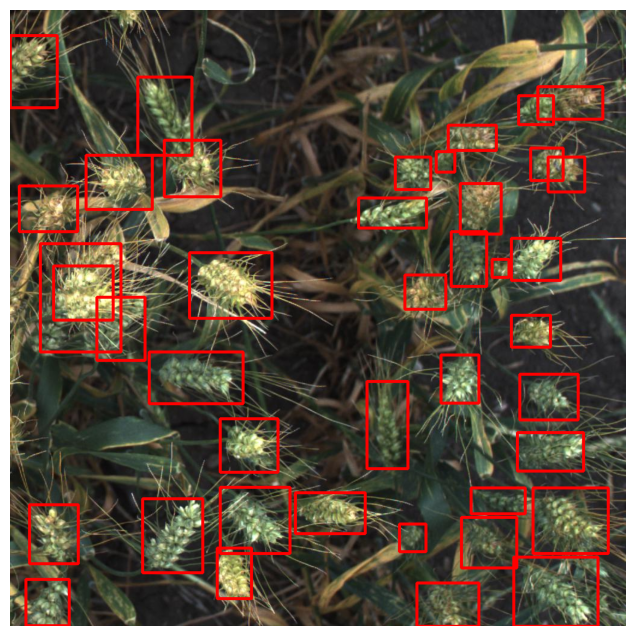

In [17]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8))

for box in boxes:
    cv2.rectangle(sample,
                  (box[0], box[1]),
                  (box[2], box[3]),
                  (220, 0, 0), 3)
    
ax.set_axis_off()
ax.imshow(sample)

# Train

In [18]:
model.to(device)
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)
# lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)
lr_scheduler = None

num_epochs = 4


In [21]:
loss_hist = Averager()
itr = 1

for epoch in range(num_epochs):
    
    # training
    model.train()
    loss_hist.reset()
    for images, targets, image_ids in train_dataloader:
        
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
        
        loss_dict = model(images, targets)
        
        losses = sum(loss for loss in loss_dict.values())
        loss_value = losses.item()
        
        loss_hist.send(loss_value)
        
        optimizer.zero_grad()
        losses.backward()
        optimizer.step()
        
        if itr % 50 == 0:
            print(f"Iteration #{itr} train loss: {loss_value}")
            
        itr += 1
    
    if lr_scheduler is not None:
        lr_scheduler.step()
        
    train_loss = loss_hist.value
        
    print(f"Epoch #{epoch} train loss: {train_loss}")
    

Iteration #50 train loss: 1.0150204827105964
Iteration #100 train loss: 0.7746749724493439
Iteration #150 train loss: 0.779301008184453
Epoch #0 train loss: 0.8755133863481356
Iteration #200 train loss: 0.8922283283979564
Iteration #250 train loss: 0.8761128209147222
Iteration #300 train loss: 0.7208498736836595
Epoch #1 train loss: 0.8604924928866472


In [22]:
images, targets, image_ids = next(iter(valid_dataloader))

In [23]:
images = list(img.to(device) for img in images)
targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

In [24]:
boxes = targets[1]['boxes'].cpu().numpy().astype(np.int32)
sample = images[1].permute(1,2,0).cpu().numpy()

In [25]:
model.eval()
cpu_device = torch.device('cpu')

outputs = model(images)
outputs = [{k: v.to(cpu_device) for k, v in t.items()} for t in outputs]

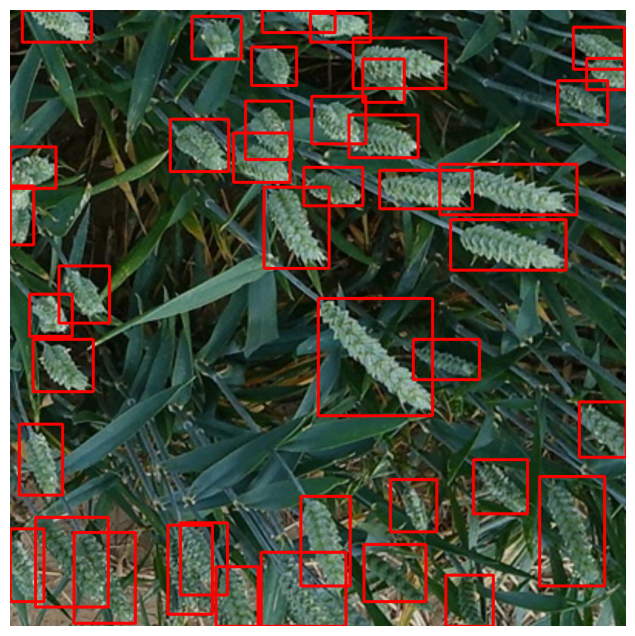

In [26]:
fig, ax = plt.subplots(1, 1, figsize=(16, 8))

for box in boxes:
    cv2.rectangle(sample,
                  (box[0], box[1]),
                  (box[2], box[3]),
                  (220, 0, 0), 3)
    
ax.set_axis_off()
ax.imshow(sample)

In [27]:
torch.save(model.state_dict(), 'fasterrcnn_resnet50_fpn.pth')

# Predict Test Samples

In [2]:
WEIGHTS_FILE = '/kaggle/input/global-wheat-detection-fastrcnn-pytorch/fasterrcnn_resnet50_fpn.pth'

model = torchvision.models.detection.fasterrcnn_resnet50_fpn(weights=None, weights_backbone=None)

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
       

In [3]:
num_classes = 2  # 1 class (wheat) + background

# get number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features

# replace the pre-trained head with a new one
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)

# Load the trained weights
model.load_state_dict(torch.load(WEIGHTS_FILE, map_location=device))


<All keys matched successfully>

In [4]:
# Albumentations
def get_test_transform():
    return A.Compose([
        # A.Resize(512, 512),
        ToTensorV2(p=1.0)
    ])

In [5]:
test_df = pd.read_csv(f'{DIR_INPUT}/sample_submission.csv')
test_df.shape

(10, 2)

In [6]:
class WheatTestDataset(Dataset):

    def __init__(self, dataframe, image_dir, transforms=None):
        super().__init__()

        self.image_ids = dataframe['image_id'].unique()
        self.df = dataframe
        self.image_dir = image_dir
        self.transforms = transforms

    def __getitem__(self, index: int):

        image_id = self.image_ids[index]
        records = self.df[self.df['image_id'] == image_id]

        image = cv2.imread(f'{self.image_dir}/{image_id}.jpg', cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0

        if self.transforms:
            sample = {
                'image': image,
            }
            sample = self.transforms(**sample)
            image = sample['image']

        return image, image_id

    def __len__(self) -> int:
        return self.image_ids.shape[0]

In [7]:
def collate_fn(batch):
    return tuple(zip(*batch))

test_dataset = WheatTestDataset(test_df, DIR_TEST, get_test_transform())

test_dataloader = DataLoader(
    test_dataset,
    batch_size=4,
    shuffle=False,
    num_workers=4,
    drop_last=False,
    collate_fn=collate_fn
)

In [8]:
def format_prediction_string(boxes, scores):
    pred_strings = []
    for j in zip(scores, boxes):
        pred_strings.append("{0:.4f} {1} {2} {3} {4}".format(j[0], j[1][0], j[1][1], j[1][2], j[1][3]))

    return " ".join(pred_strings)

In [43]:
detection_threshold = 0.5
results = []
output_images = []
output_outputs = []

model.eval()
for images, image_ids in test_dataloader:
    
    images = list(image.to(device) for image in images)
    outputs = model(images)
    
    output_images += images
    output_outputs += outputs
    
    for i, image in enumerate(images):
        
        boxes = outputs[i]['boxes'].data.cpu().numpy()
        scores = outputs[i]['scores'].data.cpu().numpy()
        res_boxes = boxes
        res_scores = scores
        
        boxes = boxes[scores >= detection_threshold].astype(np.int32)
        scores = scores[scores >= detection_threshold]
        image_id = image_ids[i]
        
        # x2, y2 -> w, h
        boxes[:, 2] = boxes[:, 2] - boxes[:, 0]
        boxes[:, 3] = boxes[:, 3] - boxes[:, 1]
        
        result = {
            'image_id': image_id,
            'PredictionString': format_prediction_string(boxes, scores)
        }
        
        results.append(result)
    

In [10]:
results[0:2]

[{'image_id': 'aac893a91',
  'PredictionString': '0.9844 74 1 93 160 0.9788 617 918 76 104 0.9713 742 772 76 114 0.9680 558 527 120 185 0.9671 29 453 101 158 0.9666 820 709 105 199 0.9656 692 388 118 176 0.9645 588 774 94 124 0.9621 356 534 95 79 0.9569 458 860 83 87 0.9502 305 0 73 68 0.9481 552 74 132 174 0.9455 333 663 113 155 0.9333 176 570 111 182 0.9156 240 848 147 86 0.8829 96 621 116 71 0.8730 828 627 82 129 0.8695 65 859 117 69 0.8651 247 99 128 130 0.8222 441 695 104 86 0.7176 395 331 76 84 0.7135 168 6 72 139 0.6720 247 93 69 70 0.6436 363 264 74 88 0.5691 818 931 129 89 0.5630 622 1 116 134'},
 {'image_id': '51f1be19e',
  'PredictionString': '0.9544 498 477 204 101 0.9494 22 0 90 71 0.9483 184 925 118 97 0.9461 809 765 104 92 0.9448 763 884 153 107 0.9436 281 477 135 113 0.9425 609 99 156 166 0.9424 842 270 129 196 0.9388 813 96 119 73 0.9335 654 795 111 78 0.9323 775 27 117 67 0.9206 0 383 57 105 0.9011 694 918 87 89 0.8947 653 580 113 96 0.8616 857 650 158 114 0.8562 342 

In [11]:
test_df = pd.DataFrame(results, columns=['image_id', 'PredictionString'])
test_df.head()

,image_id,PredictionString
0,aac893a91,0.9844 74 1 93 160 0.9788 617 918 76 104 0.971...
1,51f1be19e,0.9544 498 477 204 101 0.9494 22 0 90 71 0.948...
2,f5a1f0358,0.9738 541 273 111 111 0.9711 687 203 113 89 0...
3,796707dd7,0.9593 895 335 106 88 0.9523 707 835 103 89 0....
4,51b3e36ab,0.9817 829 459 194 145 0.9812 236 645 93 160 0...


In [49]:
output_data = []

for image, output in zip(output_images, output_outputs):
    sample = image.permute(1,2,0).cpu().numpy()
    boxes = output['boxes'].data.cpu().numpy()
    scores = output['scores'].data.cpu().numpy()
    boxes = boxes[scores >= detection_threshold].astype(np.int32)
    
    output_data.append((sample, boxes, scores))

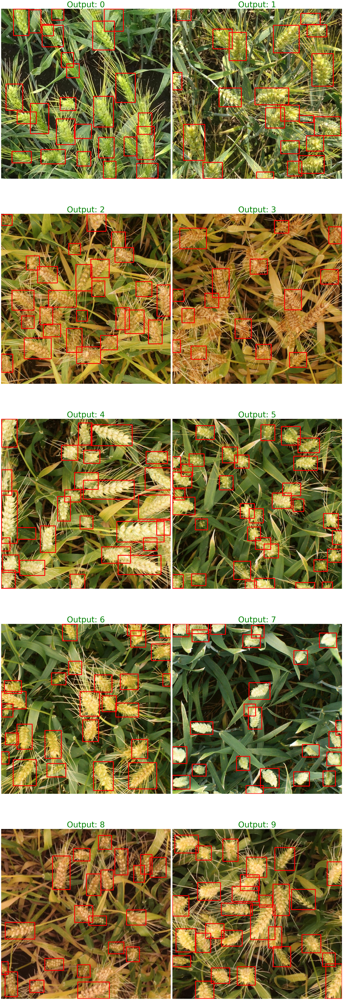

In [59]:
fig, axes = plt.subplots(5, 2, figsize=(30, 90))
axes = axes.flatten()

for i, results in enumerate(output_data):
    sample, boxes, scores = results
    for box in boxes:
        cv2.rectangle(sample,(box[0], box[1]), (box[2], box[3]), (220, 0, 0), 3)
    axes[i].imshow(sample)
    title = f"Output: {i}"
    t_color = 'green'
    axes[i].set_title(title, color=t_color, fontsize=50)
    axes[i].axis('off')

plt.tight_layout()
plt.show()

In [45]:
test_df.to_csv('submission.csv', index=False)